# Problem Statement

## 1. Import the data and understand the structure of the data:

### Usual exploratory analysis steps like checking the structure & characteristics of the dataset

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
sns.set(style="darkgrid")

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor

import torch
import torchvision
import torch.nn as nn
from torch.utils.data import DataLoader,Dataset, random_split

from tqdm import tqdm_notebook as tqdm
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv("dataset.csv")
df.head()

,market_id,created_at,actual_delivery_time,store_id,store_primary_category,order_protocol,total_items,subtotal,num_distinct_items,min_item_price,max_item_price,total_onshift_partners,total_busy_partners,total_outstanding_orders
0,1.0,2015-02-06 22:24:17,2015-02-06 23:27:16,df263d996281d984952c07998dc54358,american,1.0,4,3441,4,557,1239,33.0,14.0,21.0
1,2.0,2015-02-10 21:49:25,2015-02-10 22:56:29,f0ade77b43923b38237db569b016ba25,mexican,2.0,1,1900,1,1400,1400,1.0,2.0,2.0
2,3.0,2015-01-22 20:39:28,2015-01-22 21:09:09,f0ade77b43923b38237db569b016ba25,NaN,1.0,1,1900,1,1900,1900,1.0,0.0,0.0
3,3.0,2015-02-03 21:21:45,2015-02-03 22:13:00,f0ade77b43923b38237db569b016ba25,NaN,1.0,6,6900,5,600,1800,1.0,1.0,2.0
4,3.0,2015-02-15 02:40:36,2015-02-15 03:20:26,f0ade77b43923b38237db569b016ba25,NaN,1.0,3,3900,3,1100,1600,6.0,6.0,9.0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 197428 entries, 0 to 197427
Data columns (total 14 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   market_id                 196441 non-null  float64
 1   created_at                197428 non-null  object 
 2   actual_delivery_time      197421 non-null  object 
 3   store_id                  197428 non-null  object 
 4   store_primary_category    192668 non-null  object 
 5   order_protocol            196433 non-null  float64
 6   total_items               197428 non-null  int64  
 7   subtotal                  197428 non-null  int64  
 8   num_distinct_items        197428 non-null  int64  
 9   min_item_price            197428 non-null  int64  
 10  max_item_price            197428 non-null  int64  
 11  total_onshift_partners    181166 non-null  float64
 12  total_busy_partners       181166 non-null  float64
 13  total_outstanding_orders  181166 non-null  f

In [4]:
df.columns

Index(['market_id', 'created_at', 'actual_delivery_time', 'store_id',
       'store_primary_category', 'order_protocol', 'total_items', 'subtotal',
       'num_distinct_items', 'min_item_price', 'max_item_price',
       'total_onshift_partners', 'total_busy_partners',
       'total_outstanding_orders'],
      dtype='object')

In [5]:
df.describe()

,market_id,order_protocol,total_items,subtotal,num_distinct_items,min_item_price,max_item_price,total_onshift_partners,total_busy_partners,total_outstanding_orders
count,196441.000000,196433.000000,197428.000000,197428.000000,197428.000000,197428.000000,197428.000000,181166.000000,181166.000000,181166.000000
mean,2.978706,2.882352,3.196391,2682.331402,2.670791,686.218470,1159.588630,44.808093,41.739747,58.050065
std,1.524867,1.503771,2.666546,1823.093688,1.630255,522.038648,558.411377,34.526783,32.145733,52.661830
min,1.000000,1.000000,1.000000,0.000000,1.000000,-86.000000,0.000000,-4.000000,-5.000000,-6.000000
25%,2.000000,1.000000,2.000000,1400.000000,1.000000,299.000000,800.000000,17.000000,15.000000,17.000000
50%,3.000000,3.000000,3.000000,2200.000000,2.000000,595.000000,1095.000000,37.000000,34.000000,41.000000
75%,4.000000,4.000000,4.000000,3395.000000,3.000000,949.000000,1395.000000,65.000000,62.000000,85.000000
max,6.000000,7.000000,411.000000,27100.000000,20.000000,14700.000000,14700.000000,171.000000,154.000000,285.000000


In [6]:
df.describe(include="object")

,created_at,actual_delivery_time,store_id,store_primary_category
count,197428,197421,197428,192668
unique,180985,178110,6743,74
top,2015-02-11 19:50:43,2015-02-11 20:40:45,d43ab110ab2489d6b9b2caa394bf920f,american
freq,6,5,937,19399


In [7]:
df.shape

(197428, 14)

## 2. Data preprocessing

1. Cleaning of data
- Convert created_at column datatype to datetime
- Convert actual_delivery_time  to datetime format

In [8]:
df["created_at"] = pd.to_datetime(df["created_at"])
df["actual_delivery_time"] = pd.to_datetime(df["actual_delivery_time"])

In [9]:
df.isnull().sum()

market_id                     987
created_at                      0
actual_delivery_time            7
store_id                        0
store_primary_category       4760
order_protocol                995
total_items                     0
subtotal                        0
num_distinct_items              0
min_item_price                  0
max_item_price                  0
total_onshift_partners      16262
total_busy_partners         16262
total_outstanding_orders    16262
dtype: int64

2. Feature engineering: Creating the target column

In [10]:
df["delivery_time"] = (df["actual_delivery_time"]-df["created_at"]).dt.total_seconds()/60
df["created_hour"] = df["created_at"].dt.hour
df["day_of_week"] = df["created_at"].dt.day_of_week

## 3. Handling null values

In [11]:
df.isnull().sum()

market_id                     987
created_at                      0
actual_delivery_time            7
store_id                        0
store_primary_category       4760
order_protocol                995
total_items                     0
subtotal                        0
num_distinct_items              0
min_item_price                  0
max_item_price                  0
total_onshift_partners      16262
total_busy_partners         16262
total_outstanding_orders    16262
delivery_time                   7
created_hour                    0
day_of_week                     0
dtype: int64

- we can import null values for the column store_primary_category with reference values
- Remaining we have filled with values:0
- Continuous variable will be filled with median values 

In [12]:
values = {}
for i in df["store_id"]:
    if i not in values:
        dict = {}
        for j in df[df["store_id"] == i]["store_primary_category"]:
            if j in dict:
                dict[j] += 1
            dict[j] = 1
        values[i] = max(dict, key= lambda x: dict[x])
df["store_primary_category"] = df.apply(lambda x: values[x["store_id"]] if x["store_primary_category"] != x["store_primary_category"] else x["store_primary_category"],axis=1)
df["store_primary_category"] = df["store_primary_category"].fillna(0)

In [13]:
df["order_protocol"] = df["order_protocol"].fillna(df["order_protocol"].median())
df["total_onshift_partners"] = df["total_onshift_partners"].fillna(df["total_onshift_partners"].median())
df["total_busy_partners"] = df["total_busy_partners"].fillna(df["total_busy_partners"].median())
df["total_outstanding_orders"] = df["total_outstanding_orders"].fillna(df["total_outstanding_orders"].median())
df["market_id"] = df["market_id"].fillna(0)

In [14]:
df.dropna(inplace=True)

## 4. Encoding categorical columns

In [15]:
val = {}
for i, value in enumerate(df["store_primary_category"].unique()):
    if i < 17:
        val[value] = i+1
    elif i == 16 and value == 0:
        val[value] = 0
    else:
        val[value] = i
val[0] = 0
df["store_primary_category"].replace(val,inplace=True)

## 5. Data visualization and cleaning

1. Visualize various columns for better understanding Countplots, scatterplots

<Axes: xlabel='num_distinct_items', ylabel='count'>

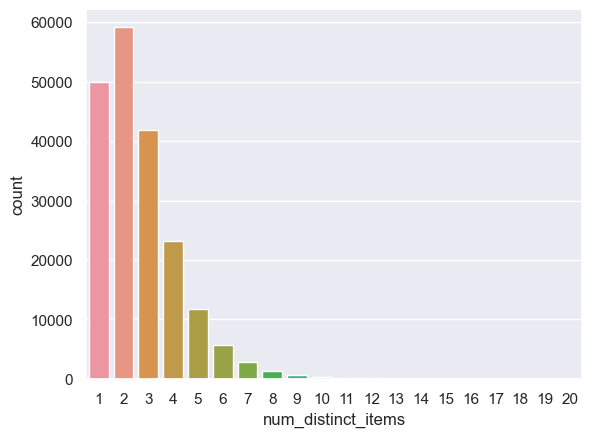

In [17]:
sns.countplot(data=df,x="num_distinct_items")

<Axes: xlabel='order_protocol', ylabel='subtotal'>

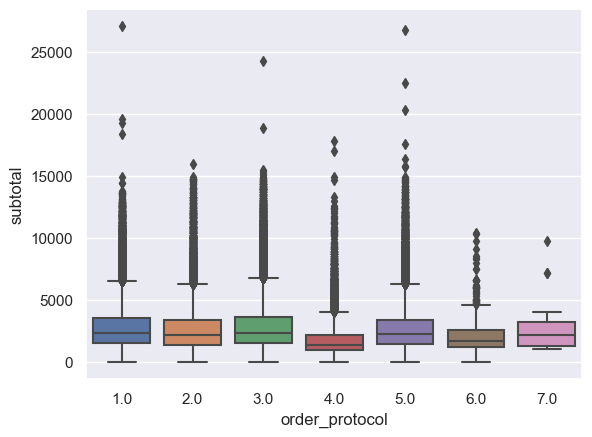

In [18]:
sns.boxplot(data= df ,x ="order_protocol",y= "subtotal")

<Axes: xlabel='day_of_week', ylabel='subtotal'>

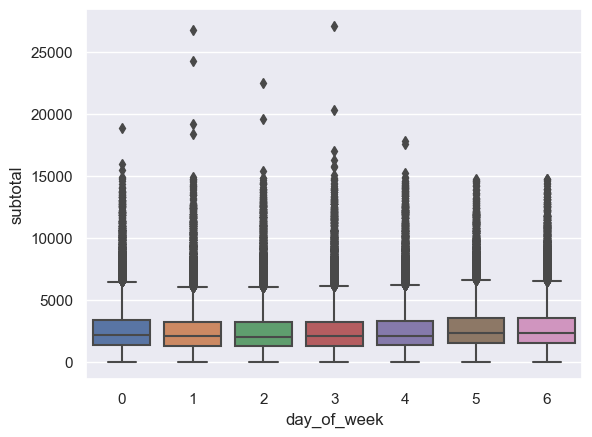

In [19]:
sns.boxplot(data= df ,x ="day_of_week",y= "subtotal")

In [20]:
fig = px.scatter(df,x ="total_items",y= "subtotal",color="day_of_week",size="max_item_price")
fig.show()

<Axes: xlabel='total_items', ylabel='subtotal'>

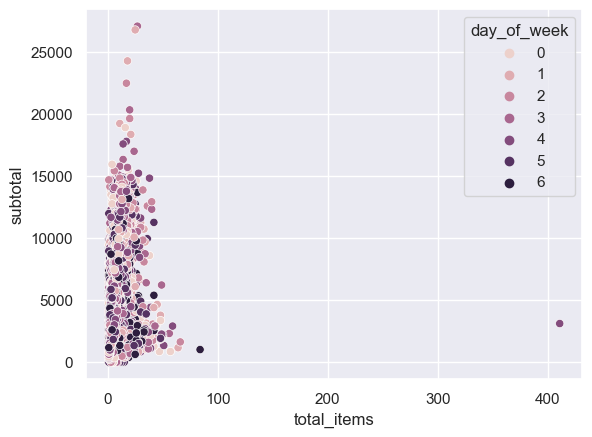

In [21]:
sns.scatterplot(data= df ,x ="total_items",y= "subtotal",hue="day_of_week")

In [22]:
fig = px.pie(df, values='subtotal', names='day_of_week',title="Percentile of subtotal in day of week",color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

## 6. Check if the data contains outliers

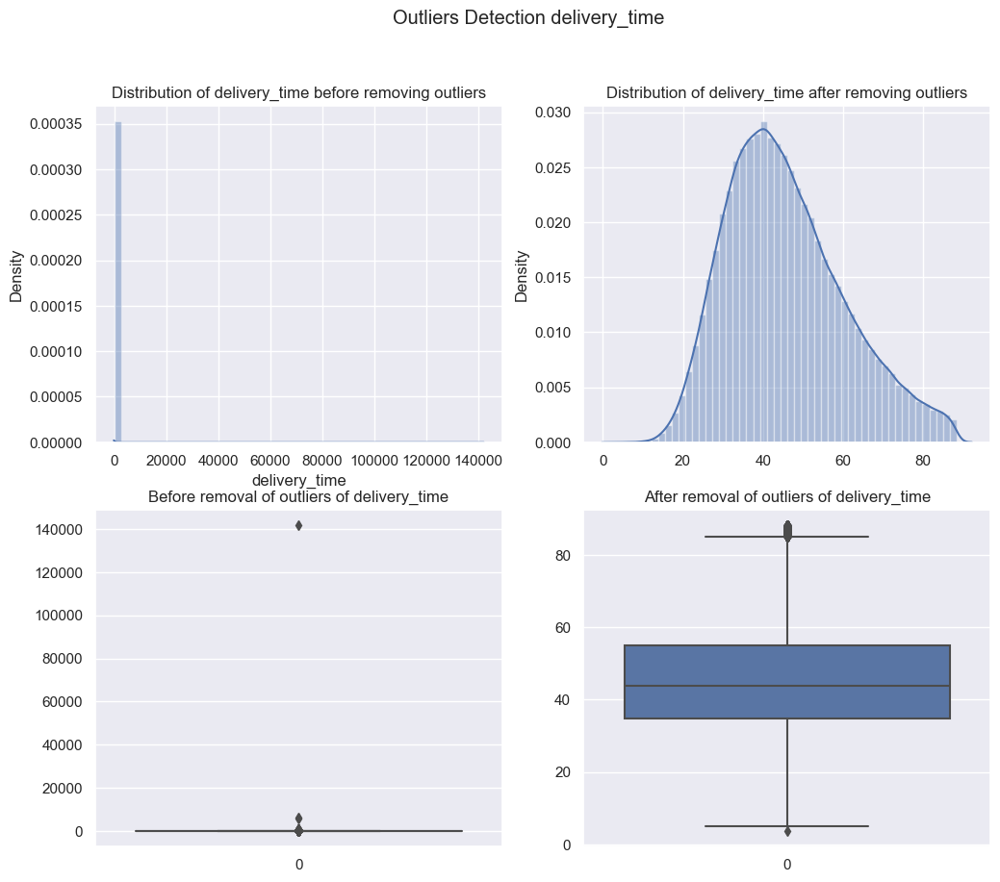

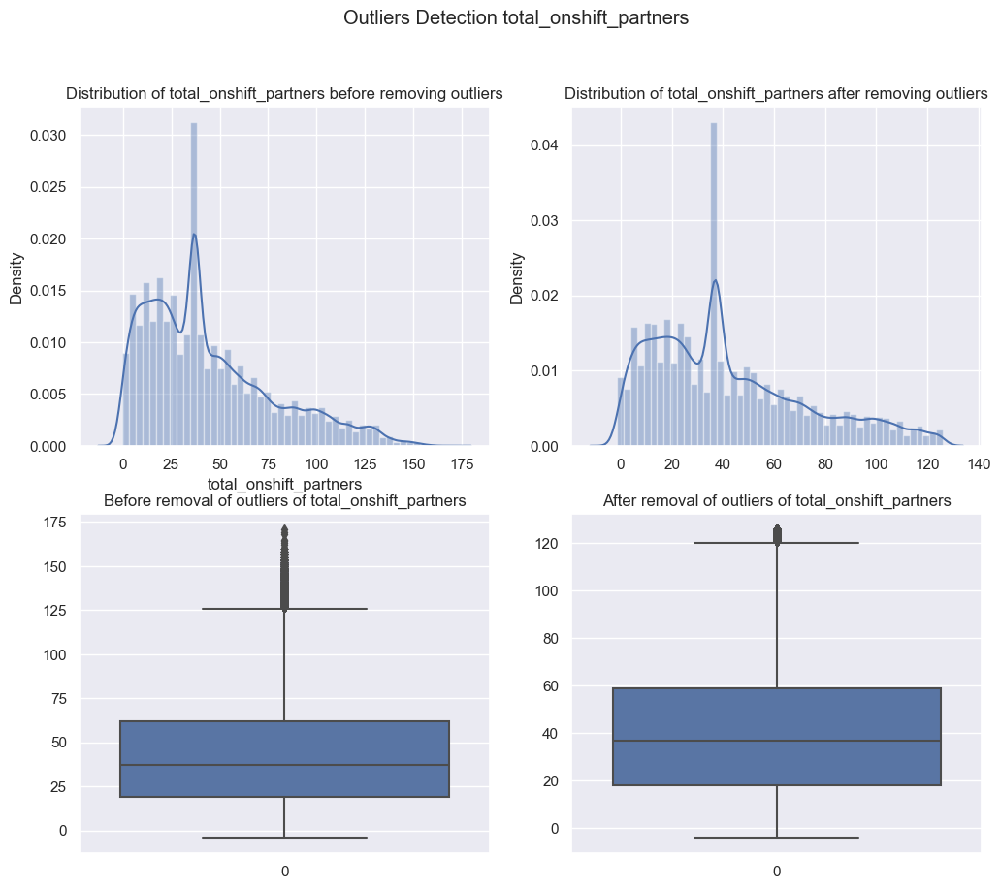

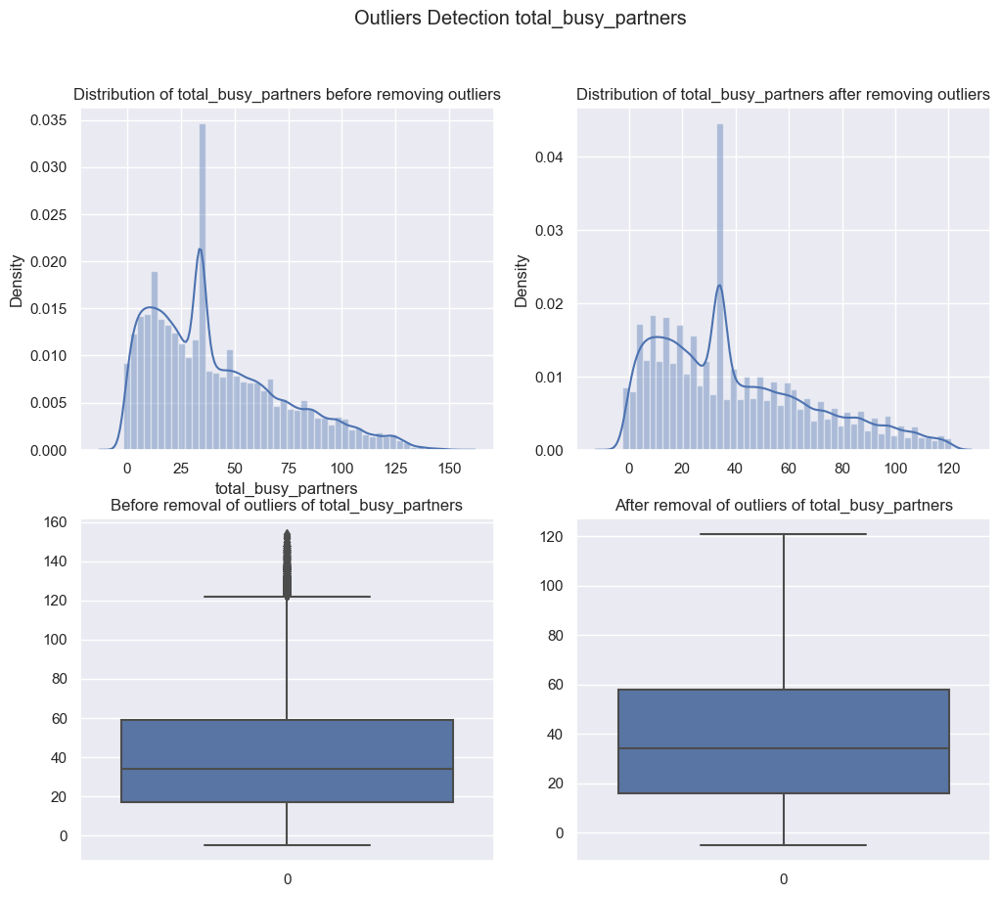

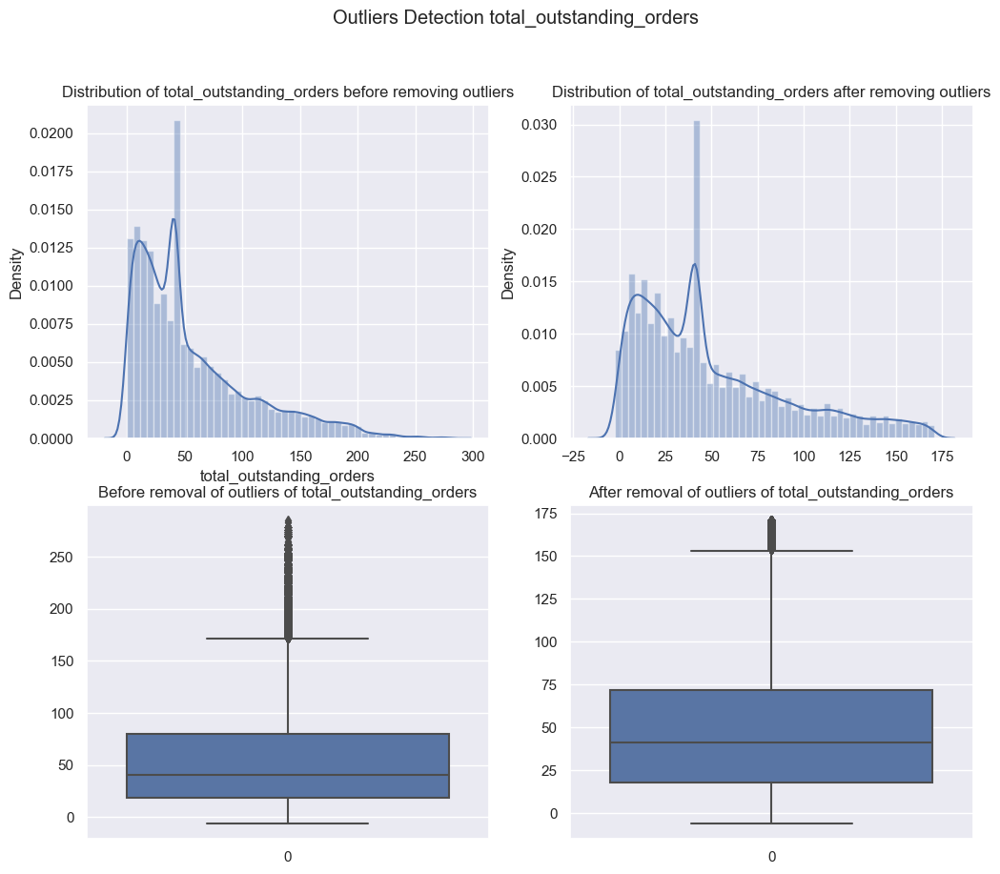

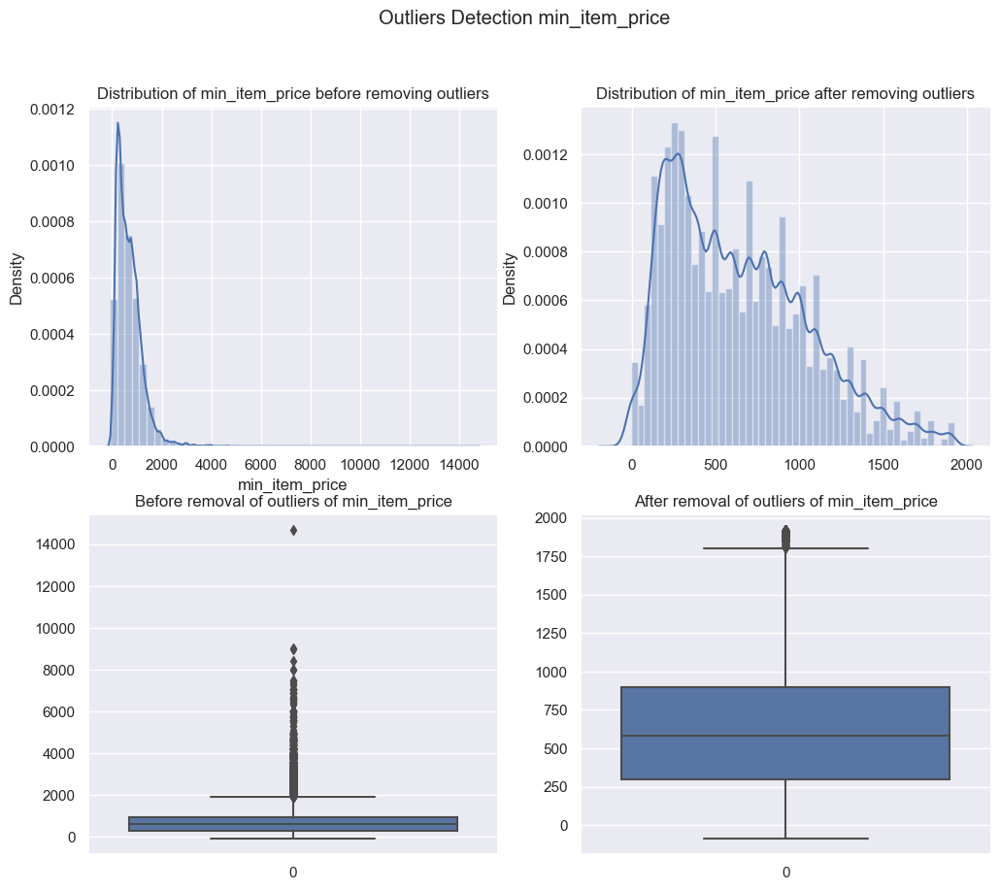

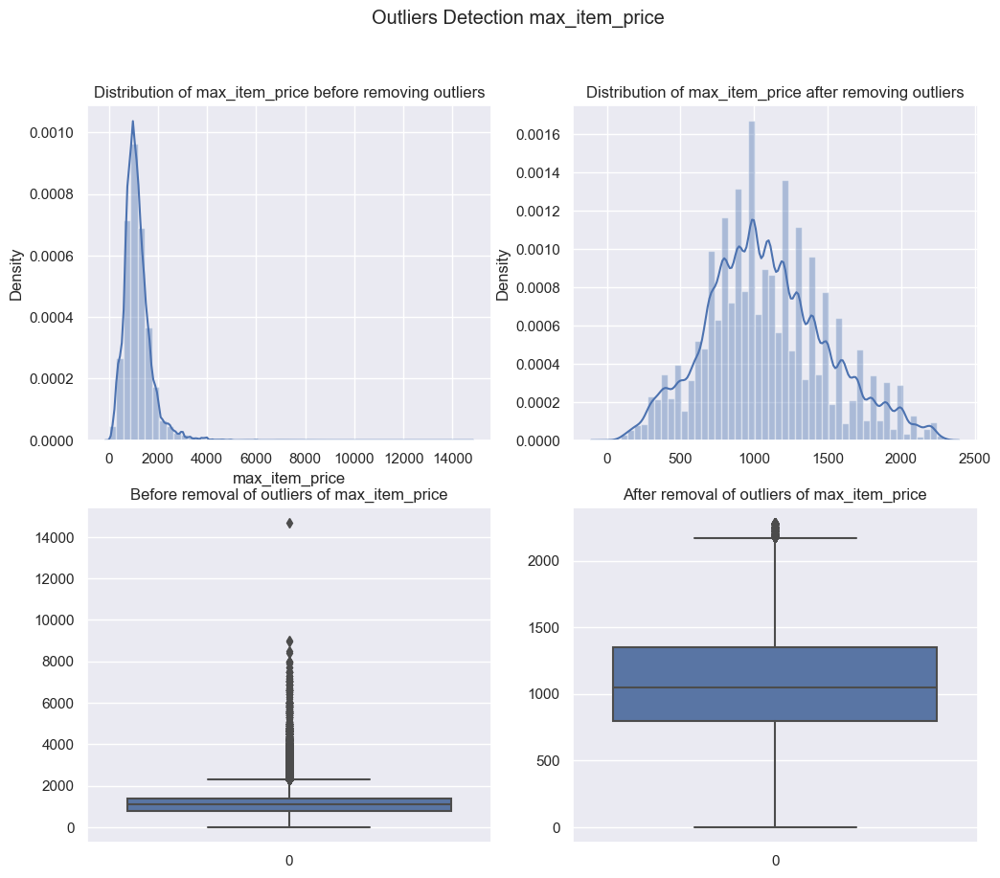

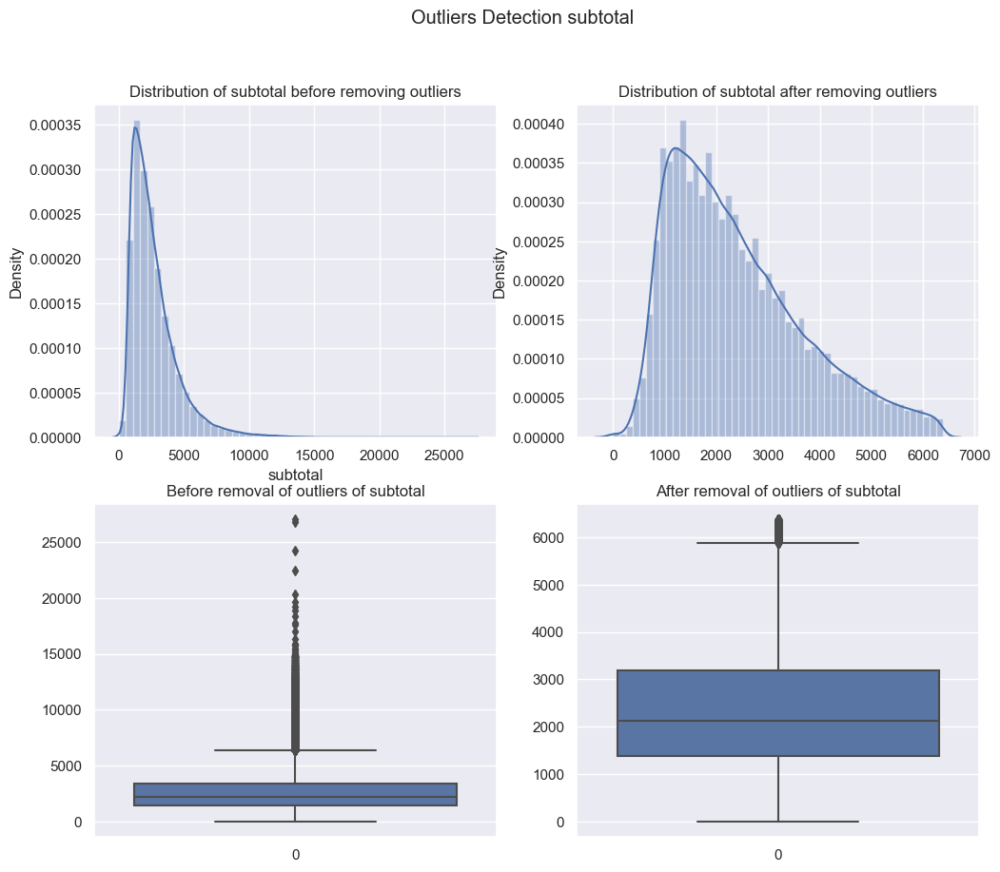

In [23]:
numerical_variable = ["delivery_time"	,"total_onshift_partners", "total_busy_partners","total_outstanding_orders","min_item_price","max_item_price","subtotal"]
for i in range(len(numerical_variable)):
    col = numerical_variable[i]

    upper = df[col].quantile(.75)
    lower = df[col].quantile(.25)
    iqr = upper - lower
    upper_limit = upper + 1.5 * iqr
    lower_limit = lower - 1.5 * iqr

    #Non_outlier data
    non_outlier_data = np.array(df[(df[col] < upper_limit) & (df[col] > lower_limit)][col]).reshape(1,-1)
    # Even though we have filtered outliers based on IQR range
    # But data still have outliers values, this can be ignorable

    fig, axes = plt.subplots(2,2, figsize=(12,10))
    fig.suptitle(f"Outliers Detection {numerical_variable[i]}")
    sns.distplot(ax = axes[0,0],a=df[numerical_variable[i]])
    axes[0,0].set_title(f"Distribution of {numerical_variable[i]} before removing outliers")
    sns.distplot(ax = axes[0,1],a=non_outlier_data)
    axes[0,1].set_title(f"Distribution of {numerical_variable[i]} after removing outliers")
    sns.boxplot(ax = axes[1,0],data = df[numerical_variable[i]])
    axes[1,0].set_title(f"Before removal of outliers of {numerical_variable[i]}")
    sns.boxplot(ax = axes[1,1],data=non_outlier_data)
    axes[1,1].set_title(f"After removal of outliers of {numerical_variable[i]}")

    plt.show()

In [24]:
non_outlier = df
numerical_variable = ["delivery_time"	,"total_onshift_partners", "total_busy_partners","total_outstanding_orders","min_item_price","max_item_price","subtotal"]
for i in range(len(numerical_variable)):
    col = numerical_variable[i]

    upper = df[col].quantile(.75)
    lower = df[col].quantile(.25)
    iqr = upper - lower
    upper_limit = upper + 1.5 * iqr
    lower_limit = lower - 1.5 * iqr
    non_outlier = non_outlier[(non_outlier[col] < upper_limit) & (non_outlier[col] > lower_limit)]

In [25]:
fig = px.histogram(non_outlier,x="delivery_time")
fig.show()

## 7. Split the data in train and test

In [40]:
encoded_df = pd.get_dummies(data=non_outlier,columns=["market_id", "order_protocol"])

In [41]:
x = encoded_df.drop(["created_at","actual_delivery_time","store_id","delivery_time"],axis=1)
y = encoded_df.delivery_time.values
feature_list = list(x.columns)
x = x.values

In [42]:
xtrain,xtest,ytrain,ytest = train_test_split(x,y,train_size=0.8)
print(xtrain.shape)
print(xtest.shape)
print(ytrain.shape)
print(ytest.shape)

(132852, 25)
(33213, 25)
(132852,)
(33213,)


In [43]:
sc = StandardScaler()
xtrain = sc.fit_transform(xtrain)
xtest = sc.transform(xtest)

- Initialize the model
- Checking on which parameter our model gives high accuracy with cross val score
- Hyper parameter tuning of estimators in our model

  0%|          | 0/14 [00:00<?, ?it/s]

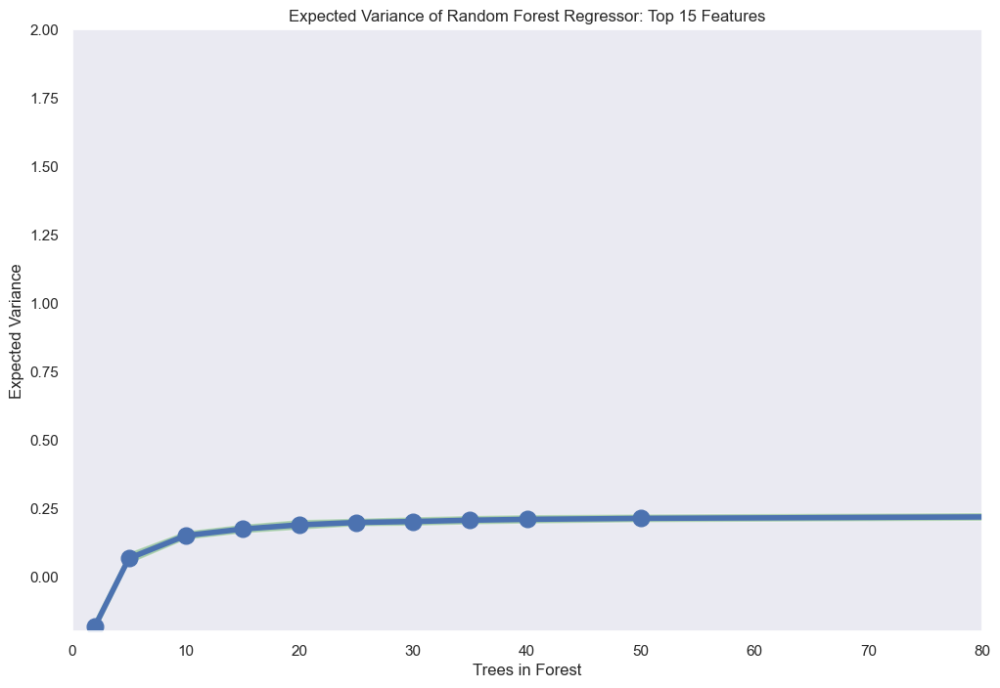

In [104]:
estimators = [2, 5, 10, 15, 20, 25, 30, 35, 40,50,100,250,500,1000]
mean_rfrs = []
std_rfrs_upper = []
std_rfrs_lower = []
np.random.seed(11111)
# for each number of estimators, fit the model and find the results for 8-fold cross validation
for i in tqdm(estimators):
    model = RandomForestRegressor(n_estimators=i,max_depth=None,n_jobs=-1)
    scores_rfr = cross_val_score(model,xtrain,ytrain,cv=10)
    mean_rfrs.append(scores_rfr.mean())
    std_rfrs_upper.append(scores_rfr.mean()+scores_rfr.std()*2) # for error plotting
    std_rfrs_lower.append(scores_rfr.mean()-scores_rfr.std()*2)

fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
ax.plot(estimators,mean_rfrs,marker='o',
        linewidth=4,markersize=12)
ax.fill_between(estimators,std_rfrs_lower,std_rfrs_upper,
                facecolor='green',alpha=0.3,interpolate=True)
ax.set_ylim([-.2,2])
ax.set_xlim([0,80])
plt.title('Expected Variance of Random Forest Regressor: Top 15 Features')
plt.ylabel('Expected Variance')
plt.xlabel('Trees in Forest')
plt.grid()
plt.show()

In [44]:
model = RandomForestRegressor(n_estimators=100,max_depth=None,n_jobs=-1)
model.fit(xtrain,ytrain)

RandomForestRegressor(n_jobs=-1)

In [45]:
predictions = model.predict(xtest)
# Calculate the absolute errors
errors = abs(predictions - ytest)
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')
from sklearn.metrics import mean_squared_error
from math import sqrt

# Print out the mean sqrt error (mae)
rms = sqrt(mean_squared_error(ytest,predictions))
print('Mean Absolute Error:', round(rms,2), 'degrees.')
print("Model_score:", round(model.score(xtest,ytest)*100,2))

Mean Absolute Error: 10.15 degrees.
Mean Absolute Error: 12.83 degrees.
Model_score: 22.6


In [46]:
importances = list(model.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, importance) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: subtotal             Importance: 0.13916637466118653
Variable: total_outstanding_orders Importance: 0.11547586521776786
Variable: total_onshift_partners Importance: 0.10450167955135141
Variable: max_item_price       Importance: 0.10118971362490316
Variable: min_item_price       Importance: 0.09906593307162753
Variable: created_hour         Importance: 0.09263100736649003
Variable: store_primary_category Importance: 0.08131575944038652
Variable: total_busy_partners  Importance: 0.06823811149594594
Variable: day_of_week          Importance: 0.058289869423938455
Variable: total_items          Importance: 0.022980077631556517
Variable: num_distinct_items   Importance: 0.022521108103350115
Variable: order_protocol_1.0   Importance: 0.01207773060006196
Variable: order_protocol_5.0   Importance: 0.011488254016547312
Variable: market_id_1.0        Importance: 0.010602594347092344
Variable: order_protocol_3.0   Importance: 0.01040906335932855
Variable: order_protocol_4.0   Importance:

## 10. Scaling the data for neural networks.

In [47]:
x = encoded_df.drop(["created_at","actual_delivery_time","store_id","delivery_time"],axis=1).values
y = encoded_df.delivery_time.values

In [48]:
x = np.array(torch.nn.functional.normalize(torch.tensor(x)))

In [49]:
class MyDataset(Dataset):
    def __init__(self, data, target):
        self.data = torch.from_numpy(data).float()
        self.target = torch.from_numpy(target).float()
        
    def __getitem__(self, index):
        x = self.data[index]
        y = self.target[index]
        
        
        return x, y
    
    def __len__(self):
        return len(self.data)
    
batch = 128
dataset = MyDataset(x,y)
train,valid = random_split(dataset,[int(0.8*len(dataset)),int(0.2*len(dataset))])
train_loader = DataLoader(train,batch_size=batch,shuffle=True,drop_last=True)
valid_loader = DataLoader(valid,batch_size=batch,shuffle=False,drop_last=True)

- Simple neural network with very few layers and high learning rate == 0.01
- We didn't implement regularization or droupout techniques in first neural network

In [50]:
class Linear(nn.Module):
    def __init__(self) -> None:
        super().__init__()
        self.Linear1 = nn.Sequential(
            nn.Linear(3200,256),
            nn.Tanh()
        )
        self.Linear2 = nn.Sequential(
            nn.Linear(256,128),
            nn.ReLU()
        )
        self.Linear3 = nn.Sequential(
            nn.Linear(128,1)
        )
    def forward(self,x):
        x = x.flatten()
        out = self.Linear1(x)
        out = self.Linear2(out)
        out = self.Linear3(out)
        return out

In [51]:
device = "cuda" if torch.cuda.is_available() else "cpu"
def training_loop(epochs,model,loss,optim,train,val):
    history = []
    for epoch in tqdm(range(epochs)):
        running_loss = []
        for data,target in train:
            data,target = data.to(device), target.to(device)
            out = model(data)
            train_loss = loss(out,target)
            train_loss.backward()
            optim.step()
            optim.zero_grad()
            running_loss.append(train_loss)
        with torch.no_grad():
            model.eval()
            val_running_loss = []
            for val_data,val_target in val:
                val_data, val_target = val_data.to(device),val_target.to(device)
                val_out = model(val_data)
                val_loss = loss(val_out,val_target)
            val_running_loss.append(val_loss)
        
        print(f"Train_loss: {torch.tensor(running_loss).mean()} Val_loss : {torch.tensor(val_running_loss).mean()}")
        history.append({"Train_loss":torch.tensor(running_loss).mean(),
                        "Val_loss":torch.tensor(val_running_loss).mean()})
    return history

model = Linear()
model.to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(params=model.parameters(),lr=0.001)
hist = training_loop(epochs=10,model=model,loss=criterion,optim=optimizer,train=train_loader,val=valid_loader)


  0%|          | 0/10 [00:00<?, ?it/s]

Train_loss: 244.56289672851562 Val_loss : 183.87179565429688
Train_loss: 211.4013214111328 Val_loss : 184.38873291015625
Train_loss: 211.2703094482422 Val_loss : 182.8123321533203
Train_loss: 211.49888610839844 Val_loss : 183.68630981445312
Train_loss: 211.68275451660156 Val_loss : 183.5328369140625
Train_loss: 211.38339233398438 Val_loss : 182.9574737548828
Train_loss: 211.50244140625 Val_loss : 183.0537109375
Train_loss: 211.41168212890625 Val_loss : 184.91192626953125
Train_loss: 211.3821258544922 Val_loss : 183.31280517578125
Train_loss: 211.47715759277344 Val_loss : 182.8291778564453


Text(0.5, 1.0, 'Loss per Epoch')

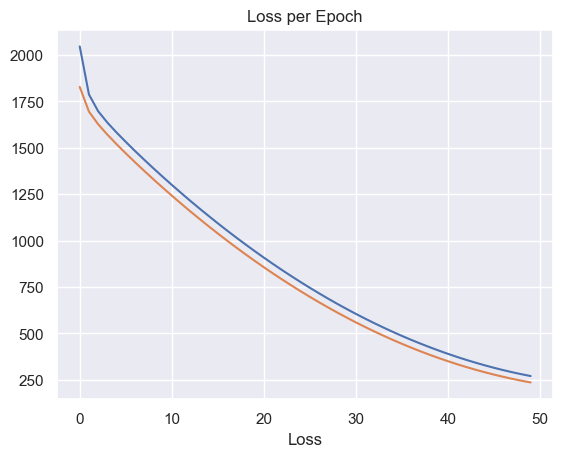

In [60]:
loss = []
val_loss = []
for i in hist:
    loss.append(i["Train_loss"])
    val_loss.append(i["Val_loss"])
plt.plot(loss)
plt.plot(val_loss)
plt.xlabel("Epochs")
plt.xlabel("Loss")
plt.title("Loss per Epoch")

# Simple model with very high rate doesn't give smooth loss and gradient
# Even model is overfitting with training data and valid data not fitting to model well

- Impoved model loss and prevents overfitting by using regularization
- used low learning rate for not exploding gradients

In [53]:
class Linear1(nn.Module):
    def __init__(self) -> None:
        super().__init__()
        self.Linear1 = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(3200,256),
            nn.Tanh()
        )
        self.Linear2 = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(256,128),
            nn.Tanh()
        )
        self.Linear3 = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(128,64),
            nn.Tanh()
        )
        self.Linear4 = nn.Sequential(
            nn.Linear(64,1)
        )
    def forward(self,x):
        x = x.flatten()
        out = self.Linear1(x)
        out = self.Linear2(out)
        out = self.Linear3(out)
        out = self.Linear4(out)
        return out

In [59]:
model = Linear1()
model.to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(params=model.parameters(),lr=0.00001,weight_decay=1e-5)
hist = training_loop(epochs=50,model=model,loss=criterion,optim=optimizer,train=train_loader,val=valid_loader)


  0%|          | 0/50 [00:00<?, ?it/s]

Train_loss: 2046.27001953125 Val_loss : 1828.04833984375
Train_loss: 1787.8150634765625 Val_loss : 1695.2904052734375
Train_loss: 1697.3505859375 Val_loss : 1627.220458984375
Train_loss: 1636.264892578125 Val_loss : 1571.291259765625
Train_loss: 1582.4930419921875 Val_loss : 1519.7386474609375
Train_loss: 1532.175048828125 Val_loss : 1470.4638671875
Train_loss: 1483.2584228515625 Val_loss : 1422.713623046875
Train_loss: 1436.116943359375 Val_loss : 1376.1741943359375
Train_loss: 1389.950927734375 Val_loss : 1330.69140625
Train_loss: 1344.789306640625 Val_loss : 1286.223876953125
Train_loss: 1300.699951171875 Val_loss : 1242.6744384765625
Train_loss: 1257.4268798828125 Val_loss : 1200.0751953125
Train_loss: 1214.9481201171875 Val_loss : 1158.3682861328125
Train_loss: 1173.5977783203125 Val_loss : 1117.5411376953125
Train_loss: 1133.25537109375 Val_loss : 1077.6309814453125
Train_loss: 1093.4569091796875 Val_loss : 1038.627197265625
Train_loss: 1054.798828125 Val_loss : 1000.504821777343

In [64]:
hist = training_loop(epochs=10,model=model,loss=criterion,optim=optimizer,train=train_loader,val=valid_loader)

  0%|          | 0/10 [00:00<?, ?it/s]

Train_loss: 213.14898681640625 Val_loss : 184.29605102539062
Train_loss: 211.9913330078125 Val_loss : 183.52081298828125
Train_loss: 211.40158081054688 Val_loss : 183.09776306152344
Train_loss: 210.96311950683594 Val_loss : 182.90313720703125
Train_loss: 210.85438537597656 Val_loss : 182.8314971923828
Train_loss: 210.77992248535156 Val_loss : 182.81326293945312
Train_loss: 210.72235107421875 Val_loss : 182.81387329101562
Train_loss: 210.67251586914062 Val_loss : 182.81727600097656
Train_loss: 210.6506805419922 Val_loss : 182.8208770751953
Train_loss: 210.6818084716797 Val_loss : 182.8221435546875


In [ ]:
loss = []
val_loss = []

Text(0.5, 1.0, 'Loss per Epoch')

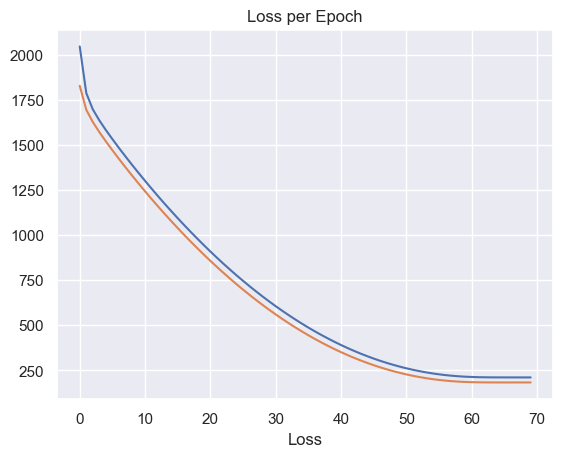

In [65]:
for i in hist:
    loss.append(i["Train_loss"])
    val_loss.append(i["Val_loss"])
plt.plot(loss)
plt.plot(val_loss)
plt.xlabel("Epochs")
plt.xlabel("Loss")
plt.title("Loss per Epoch")